### 쥬피터 노트북 창크기 조정

In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

### 테스트 및 코드 확인시 autosave 0으로 설정 후 이용
* default 0

In [2]:
%autosave 0

Autosave disabled


In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import font_manager, rc
%matplotlib inline
#pd.set_option('max_columns', 20, 'max_rows', 20) >>오류로 인한 주석

In [4]:
# 차트에서 한글 출력을 위한 설정
import platform
your_os = platform.system()
if your_os == 'Linux':
    rc('font', family='NanumGothic')
elif your_os == 'Windows':
    ttf = "c:/Windows/Fonts/malgun.ttf"
    font_name = font_manager.FontProperties(fname=ttf).get_name()
    rc('font', family=font_name)
elif your_os == 'Darwin':
    rc('font', family='AppleGothic')
rc('axes', unicode_minus=False)

In [5]:
#데이터 확인을 위해 주석 
tr = pd.read_csv('transactions.csv', encoding='cp949')
tr

,cust_id,tran_date,store_nm,goods_id,gds_grp_nm,gds_grp_mclas_nm,amount
0,0,2007-01-19 00:00:00,강남점,127105,기초 화장품,화장품,850000
1,0,2007-03-30 00:00:00,강남점,342220,니 트,시티웨어,480000
2,0,2007-03-30 00:00:00,강남점,127105,기초 화장품,화장품,3000000
3,0,2007-03-30 00:00:00,강남점,342205,니 트,시티웨어,840000
4,0,2007-03-30 00:00:00,강남점,342220,상품군미지정,기타,20000
...,...,...,...,...,...,...,...
231999,3499,2007-12-17 00:00:00,본 점,127129,상품군미지정,기타,-135000
232000,3499,2007-12-23 00:00:00,노원점,285136,시티웨어,시티웨어,6380000
232001,3499,2007-12-23 00:00:00,노원점,39107,야채,농산물,40800
232002,3499,2007-12-27 00:00:00,본 점,740120,어덜트,명품,4880000


In [6]:
features = pd.DataFrame({'cust_id': tr.cust_id.unique()})

### 데이터 설명

* 롯데백화점 구매데이터 
* cust_id : 고객 고유번호
* tran_date : 구매시간
* store_nm : 구매지점
* goods_id : 상품고유번호
* gds_grp_nm : 상품소분류
* gds_grp_mclas_nm : 상품대분류
* amount : 구입금액

### Numeric Features [파생변수 1~33]

#### [파생변수 1~5] 총구매액, 구매건수, 평균구매액, 최소구매액,최대구매액

In [7]:
p=tr.groupby('cust_id')['amount'].agg([
    ('총구매액',np.sum),
    ('구매건수',np.size),
    ('평균구매액',lambda x:np.round(np.mean(x))),
    ('최소구매액',np.min),
    ('최대구매액',np.max),
]).reset_index()
features=features.merge(p,how='left');features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액
0,0,68282840,74,922741.0,-5368000,11264000
1,1,2136000,3,712000.0,-300000,2136000
2,2,3197000,4,799250.0,64500,1639000
3,3,16077620,44,365400.0,1800,4935000
4,4,29050000,3,9683333.0,2050000,24000000
...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900
3496,3496,29628600,13,2279123.0,-6049600,7200000
3497,3497,75000,1,75000.0,75000,75000
3498,3498,1875000,2,937500.0,875000,1000000


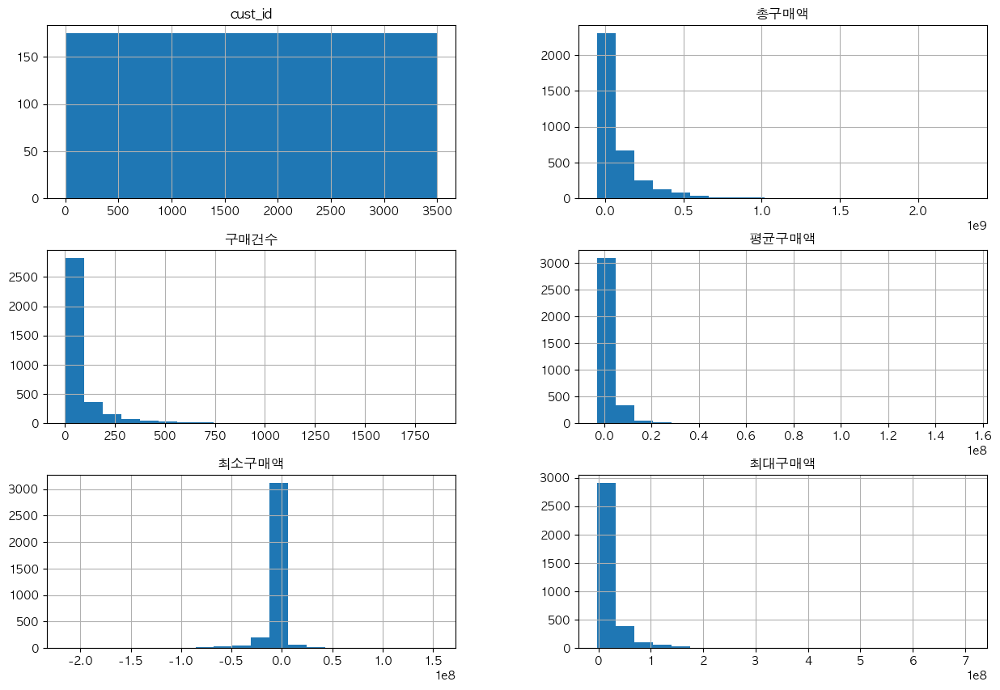

In [8]:
p.hist(bins=20, figsize=(15,10))
plt.show()

#### [파생변수 6~7] 환불금액, 환불건수

In [9]:
p=tr[tr.amount<0].groupby('cust_id')['amount'].agg([
    ('환불금액',lambda x :x.sum()*-1),
    ('환불건수',np.size)
]).reset_index()
features=features.merge(p,how='left');features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN
...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN


#### [파생변수 8~10] 구매상품종류(goos_id, gds_grp_nm,gds_mclas_nm)
* 상품 소분류, 중분류, 대분류로 상위분류에 속한 상품을 여러개 구입할 경우 구입 size가 다를 수 있음

In [10]:
p=tr.groupby('cust_id').agg({
    'goods_id':[('상품소분류',lambda x :x.nunique())],
    'gds_grp_nm':[('상품중분류',lambda x:x.nunique())],
    'gds_grp_mclas_nm':[('상품대분류',lambda x:x.nunique())]    
})
p.columns=p.columns.droplevel()
p=p.reset_index()
features=features.merge(p,how='left');features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,상품대분류
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,17
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,2
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,2
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,13
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,3
...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,2
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,5
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,1
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,1


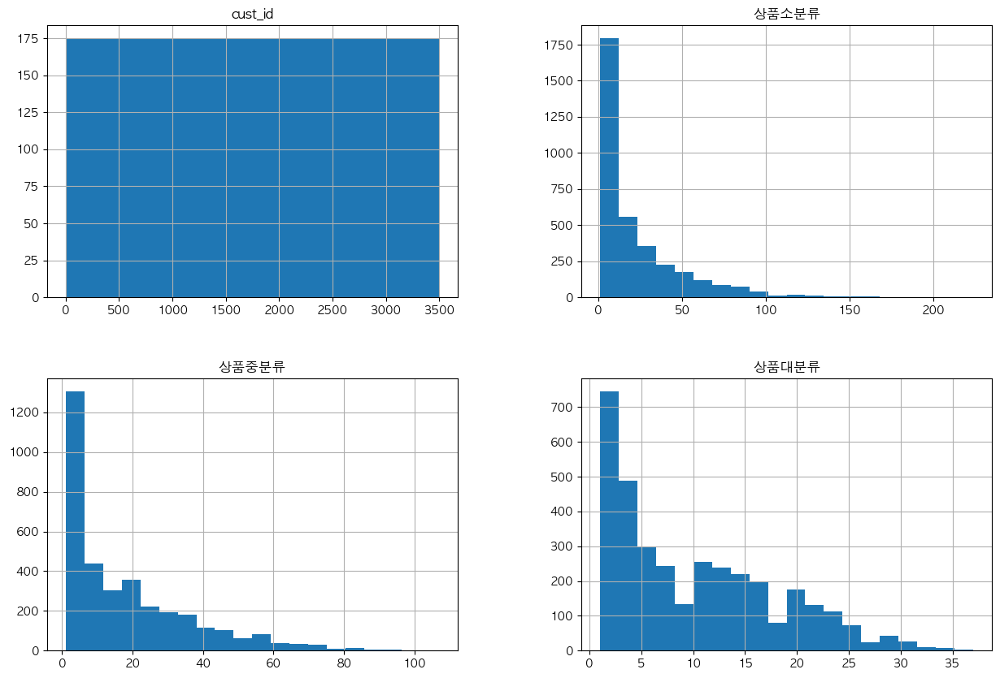

In [11]:
p.hist(bins=20,figsize=(15,10))
plt.show()

#### [파생변수11~12]최근 n 개월 내 구매 상품, 구매 건수
* 최근 n개월 내 구매 상품, 구매 건수를 비교하여 남 여를 구분하는데 도움이 될 것이라 생각
* 여성일수록 최근 구매 개월이 짧고 남성의 경우 길것으로 판단

In [12]:
# [3,6,9,12] 원하는 개월을 대입하여 추출가능
for m in [3]:
    start = str(pd.to_datetime(tr.tran_date.max()) - pd.offsets.MonthBegin(m))
    f = tr.query('tran_date >= @start').groupby('cust_id')['gds_grp_nm'].agg([
        (f'최근{m}개월_구매상품', np.sum), 
        (f'최근{m}개월_구매건수', np.size)
    ]).reset_index()
    display(p)
    features = features.merge(p, how='left'); features

,cust_id,상품소분류,상품중분류,상품대분류
0,0,35,28,17
1,1,2,2,2
2,2,1,2,2
3,3,24,20,13
4,4,2,3,3
...,...,...,...,...
3495,3495,1,2,2
3496,3496,9,7,5
3497,3497,1,1,1
3498,3498,1,1,1


In [13]:
#개선된 코드
# # pd.to_datetime(), pd.offsets.MonthBegin(3)
# for m in [3,6,12]:
#     start = str(pd.to_datetime(tr.tran_date.max()) - pd.offsets.MonthBegin(m))
#     f = tr.query('tran_date >= @start').groupby('cust_id')['amount'].agg([
#         (f'최근{m}개월_구매금액', np.sum), 
#         (f'최근{m}개월_구매건수', np.size)
#     ]).reset_index()
#     display(f)
#     features = features.merge(f, how='left'); features

#### [파생변수13~14] 세일선호도
* 백화점 세일기간은 보통 1,4,7,11 (신세계, 현대, 롯데백화점 시즌 검색) 달로 1년에 다섯번 정도 시행한다. 이 시즌에 여성들이 남성들보다 더 민감하게 반응할 것으로 판단

In [14]:
p = tr.groupby('cust_id')['tran_date'].agg([
    ('세일기간 내 구매비율', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([1,4,7,11]))),
    ('비세일기간 내 구매비율', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([2,3,5,6,8,9,12]))),    
]).reset_index()
display(p)
features = features.merge(p, how='left'); features

,cust_id,세일기간 내 구매비율,비세일기간 내 구매비율
0,0,0.229730,0.581081
1,1,0.000000,0.000000
2,2,1.000000,0.000000
3,3,0.250000,0.750000
4,4,0.666667,0.333333
...,...,...,...
3495,3495,0.000000,1.000000
3496,3496,0.000000,0.769231
3497,3497,1.000000,0.000000
3498,3498,1.000000,0.000000


,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,상품대분류,세일기간 내 구매비율,비세일기간 내 구매비율
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,17,0.229730,0.581081
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,2,0.000000,0.000000
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,2,1.000000,0.000000
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,13,0.250000,0.750000
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,3,0.666667,0.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,2,0.000000,1.000000
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,5,0.000000,0.769231
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,1,1.000000,0.000000
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,1,1.000000,0.000000


<function matplotlib.pyplot.show(close=None, block=None)>

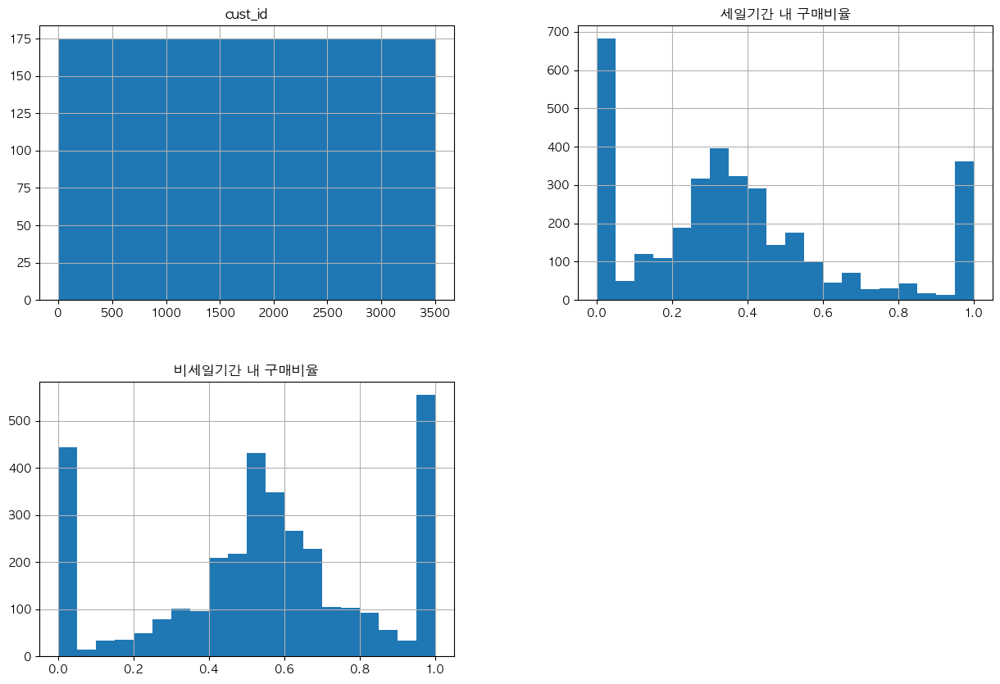

In [15]:
p.hist(bins=20, figsize=(15,10))
plt.show

#### [파생변수15~20] 시즌선호도 2
* 남성들은 세일 기간과 시즌오프에 여성들보다 덜 민감하게 반응할 것이다. 따라서 시즌 오프 전 구매 비율이 높을 것으로 판단된다.

In [16]:
p = tr.groupby('cust_id')['tran_date'].agg([
    ('시즌오프 후 구매비율', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([1,2]))),
    (' 시즌오프 전 구매비율(3-4월)', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([3,4]))),
    (' 시즌오프 전 구매비율(5-6월)', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([5,6]))),
    (' 시즌오프 전 구매비율(7-8월)', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([7,8]))),
    (' 시즌오프 전 구매비율(9-10월)', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([9,10]))),
    (' 시즌오프 전 구매비율(11-12월)', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([11,12])))
]).reset_index()
display(p)
features = features.merge(p, how='left'); features

,cust_id,시즌오프 후 구매비율,시즌오프 전 구매비율(3-4월),시즌오프 전 구매비율(5-6월),시즌오프 전 구매비율(7-8월),시즌오프 전 구매비율(9-10월),시즌오프 전 구매비율(11-12월)
0,0,0.013514,0.054054,0.108108,0.324324,0.324324,0.175676
1,1,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
2,2,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,3,0.068182,0.477273,0.204545,0.068182,0.090909,0.090909
4,4,0.000000,0.000000,0.333333,0.000000,0.000000,0.666667
...,...,...,...,...,...,...,...
3495,3495,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
3496,3496,0.076923,0.076923,0.000000,0.076923,0.461538,0.307692
3497,3497,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3498,3498,0.500000,0.500000,0.000000,0.000000,0.000000,0.000000


,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,상품대분류,세일기간 내 구매비율,비세일기간 내 구매비율,시즌오프 후 구매비율,시즌오프 전 구매비율(3-4월),시즌오프 전 구매비율(5-6월),시즌오프 전 구매비율(7-8월),시즌오프 전 구매비율(9-10월),시즌오프 전 구매비율(11-12월)
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,17,0.229730,0.581081,0.013514,0.054054,0.108108,0.324324,0.324324,0.175676
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,2,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,13,0.250000,0.750000,0.068182,0.477273,0.204545,0.068182,0.090909,0.090909
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,3,0.666667,0.333333,0.000000,0.000000,0.333333,0.000000,0.000000,0.666667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,2,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,5,0.000000,0.769231,0.076923,0.076923,0.000000,0.076923,0.461538,0.307692
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,1,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,1,1.000000,0.000000,0.500000,0.500000,0.000000,0.000000,0.000000,0.000000


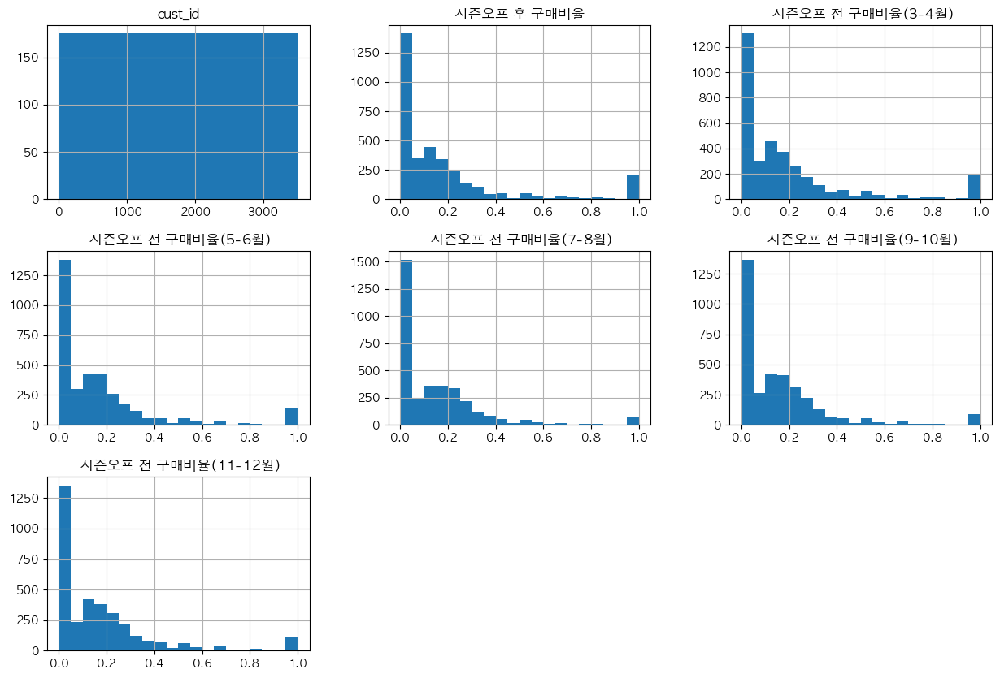

In [17]:
p.hist(bins=20,figsize=(15,10))
plt.show()

#### [파생변수 20 ~ 31] 구매추세 패턴
* 남성들은 백화점에서 필요물품만을 구입하는 편이고 여성들은 필요물품 외 세일이나 부과적인 물품을 같이 구입하는 성향이 있다고 생각. 주부들의 경우 식료품, 생활용품의 구매로 인해 구매금액은 적도 구매건수는 많을 것이다.
* 월별로 데이터를 나눠 월별 구매추세 패턴을 확인

In [18]:
p = tr.groupby('cust_id')['tran_date'].agg([
    ('1월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([1]))),
    ('2월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([2]))),
    ('3월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([3]))),
    ('4월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([4]))),
    ('5월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([5]))),
    ('6월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([6]))),
    ('7월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([7]))),
    ('8월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([8]))),
    ('9월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([9]))),
    ('10월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([10]))),
    ('11월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([11]))),
    ('12월 구매량', lambda x: np.sum(pd.to_datetime(x).dt.month.isin([12]))),
]).reset_index()
features=features.merge(p,how='left');features
#display issue로 인해 해당 시트는 features를 merge하지 않음

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,3월 구매량,4월 구매량,5월 구매량,6월 구매량,7월 구매량,8월 구매량,9월 구매량,10월 구매량,11월 구매량,12월 구매량
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,4,0,3,5,12,12,10,14,4,9
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,0,0,0,0,0,0,0,3,0,0
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,0,0,0,0,0,0,0,0,0,0
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,13,8,5,4,2,1,4,0,1,3
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,0,0,1,0,0,0,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,0,0,0,2,0,0,0,0,0,0
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,1,0,0,0,0,1,3,3,0,4
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,0,0,0,0,0,0,0,0,0,0
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,0,1,0,0,0,0,0,0,0,0


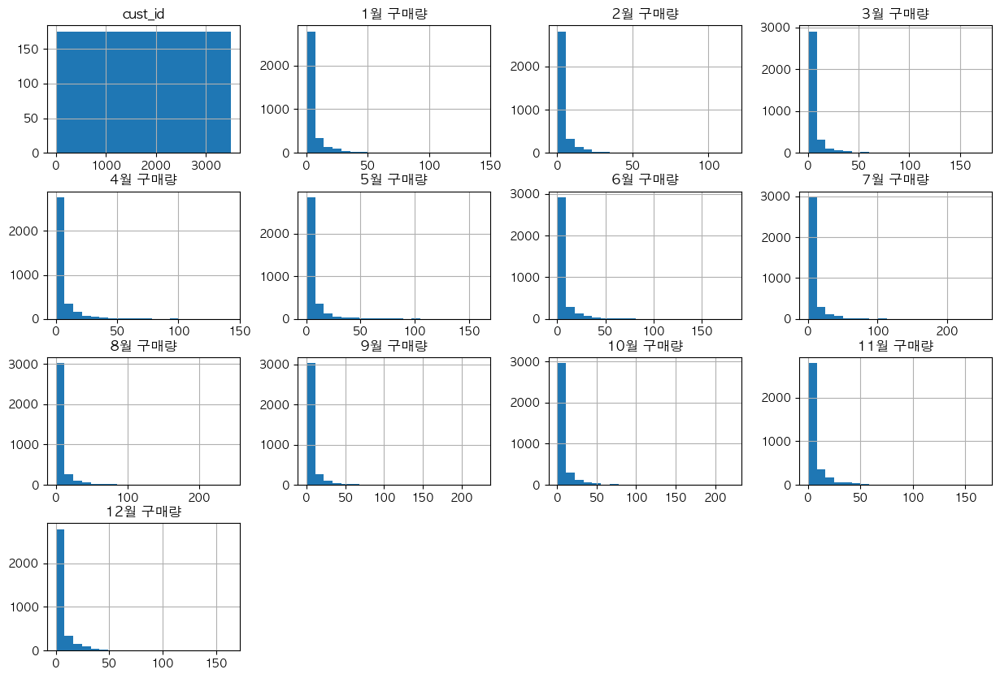

In [19]:
p.hist(bins=20,figsize=(15,10))
plt.show()

#### [파생변수 32] 주중방문비율
* 남 녀 모두 주말 방문이 높을 것으로 예상되나 여성의 경우 주부의 주중방문이 높을 것으로 예상된다

In [20]:
p = tr.groupby('cust_id')['tran_date'].agg([
    (('주중방문비율', lambda x: np.mean(pd.to_datetime(x).dt.dayofweek<4))),
    ]).reset_index()
features = features.merge(p, how='left'); features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,4월 구매량,5월 구매량,6월 구매량,7월 구매량,8월 구매량,9월 구매량,10월 구매량,11월 구매량,12월 구매량,주중방문비율
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,0,3,5,12,12,10,14,4,9,0.351351
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,0,0,0,0,0,0,3,0,0,1.000000
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,0,0,0,0,0,0,0,0,0,1.000000
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,8,5,4,2,1,4,0,1,3,0.613636
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,0,1,0,0,0,0,0,2,0,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,0,0,2,0,0,0,0,0,0,0.000000
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,0,0,0,0,1,3,3,0,4,0.461538
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,0,0,0,0,0,0,0,0,0,1.000000
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,1,0,0,0,0,0,0,0,0,1.000000


#### [파생변수 33] 가격 선호도
* 물품별 가격 선호도가 성별 유추에 도움이 될 것 같아 추출

In [21]:
p = tr.groupby('cust_id')['amount'].agg([
    ('총구매액',np.sum), 
    ('구매건수', np.size), 
    ('평균구매액', lambda x: np.round(np.mean(x))),
    ('최대구매액', np.max),
]).reset_index()

In [22]:
p['가격선호도'] = p['총구매액'] / p['구매건수']
p.head()
features = features.merge(p, how='left'); features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,5월 구매량,6월 구매량,7월 구매량,8월 구매량,9월 구매량,10월 구매량,11월 구매량,12월 구매량,주중방문비율,가격선호도
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,3,5,12,12,10,14,4,9,0.351351,9.227411e+05
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,0,0,0,0,0,3,0,0,1.000000,7.120000e+05
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,0,0,0,0,0,0,0,0,1.000000,7.992500e+05
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,5,4,2,1,4,0,1,3,0.613636,3.654005e+05
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,1,0,0,0,0,0,2,0,1.000000,9.683333e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,0,2,0,0,0,0,0,0,0.000000,1.587600e+06
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,0,0,0,1,3,3,0,4,0.461538,2.279123e+06
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,0,0,0,0,0,0,0,0,1.000000,7.500000e+04
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,0,0,0,0,0,0,0,0,1.000000,9.375000e+05


### Categorical Features [파생변수 34 ~]
* 상품카테고리와 고객이 구매한 상품카테고리는 다름 해석에 주의
* 상품카테고리 tr['gds_grp_mclas_nm'].value_counts()
* 고객구매상품 tr.groupby('cust_id)['gds_grp_mclas_nm]...

In [23]:
# Data check
# print('상품대분류',tr['gds_grp_mclas_nm'].unique())
# print('상품소분류',tr['gds_grp_nm'].unique())
# print('상품ID',tr['goods_id'].unique())
# tr['gds_grp_mclas_nm'].value_counts()

In [24]:
#상품대분류를 통한 주구매상품 추출
p=tr.groupby('cust_id')['gds_grp_mclas_nm'].agg([
    ('주구매상품',lambda x: x.value_counts().index[0])
]).reset_index()
features=features.merge(p,how='left');features['주구매상품'].nunique()

44

<AxesSubplot:xlabel='count', ylabel='주구매상품'>

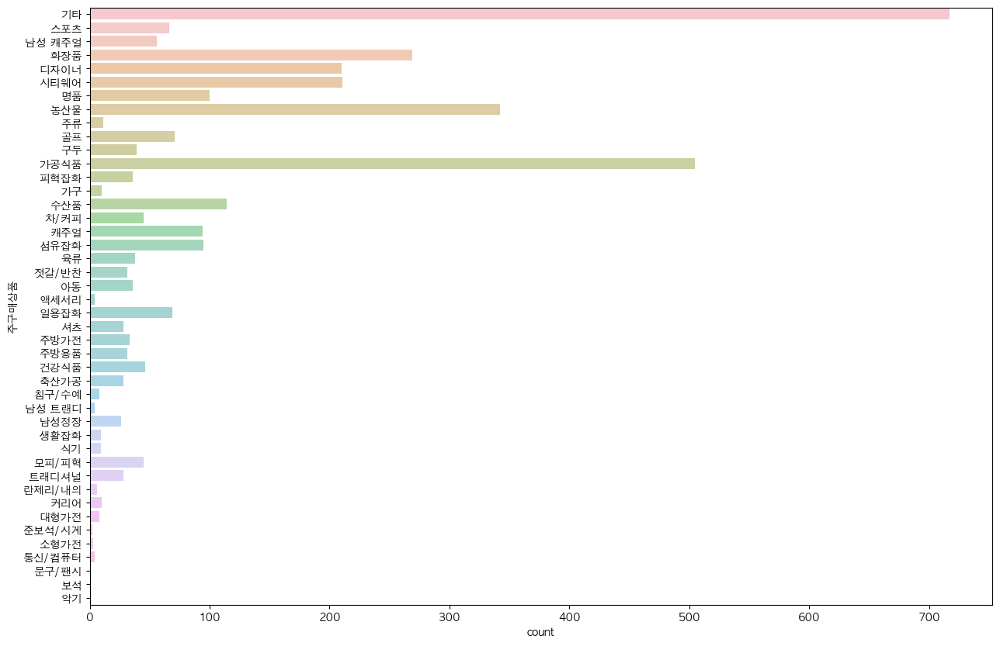

In [25]:
fig,ax=plt.subplots(figsize=(15,10))
sns.countplot(y='주구매상품',data=p,alpha=0.5)
#https://hwi-doc.tistory.com/entry/matplotlib-%EC%99%84%EB%B2%BD-%EC%A0%95%EB%A6%AC 참고
#https://datascienceschool.net/01%20python/05.04%20%EC%8B%9C%EB%B3%B8%EC%9D%84%20%EC%82%AC%EC%9A%A9%ED%95%9C%20%EB%8D%B0%EC%9D%B4%ED%84%B0%20%EB%B6%84%ED%8F%AC%20%EC%8B%9C%EA%B0%81%ED%99%94.html

#### 주구매지점
* 온라인 쇼핑몰 더미변수를 만들고 주거래 사이트, 주방문 사이트 변수도 만들 수 있을것
* 다른 feature를 만들때 활용가능성이 높아보임

In [26]:
p=tr.groupby('cust_id')['store_nm'].agg([
    ('주구매지점',lambda x:x.value_counts().index[0])
]).reset_index()
features=features.merge(p,how='left');features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,7월 구매량,8월 구매량,9월 구매량,10월 구매량,11월 구매량,12월 구매량,주중방문비율,가격선호도,주구매상품,주구매지점
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,12,12,10,14,4,9,0.351351,9.227411e+05,기타,강남점
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,0,0,0,3,0,0,1.000000,7.120000e+05,스포츠,잠실점
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,0,0,0,0,0,0,1.000000,7.992500e+05,남성 캐주얼,관악점
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,2,1,4,0,1,3,0.613636,3.654005e+05,기타,광주점
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,0,0,0,0,2,0,1.000000,9.683333e+06,화장품,본 점
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,0,0,0,0,0,0,0.000000,1.587600e+06,골프,본 점
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,0,1,3,3,0,4,0.461538,2.279123e+06,시티웨어,부산본점
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,0,0,0,0,0,0,1.000000,7.500000e+04,주방용품,창원점
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,0,0,0,0,0,0,1.000000,9.375000e+05,화장품,본 점


### 최소제곱법을 이용한 구매주기 기울기

출처 : 교수님 제공

In [27]:
#구매달만 추출하기 위해 자르기
tr['tran_month']=tr['tran_date'].apply(lambda x:x[5:7])

#월별 구매size를 알기 위해 cust_id와 tran_month를 각각 groupby
month=tr.groupby([tr['cust_id'],tr['tran_month']])['amount'].count().reset_index()
month.tran_month=month.tran_month.apply(lambda x:int(x))
df=pd.DataFrame(columns=['cust_id','tran_month'])

#cust_id와 구매 달을 추출해 빈 데이터프레임에 저장
for cust_id in range(0,5982):
    for tran_month in range(1,13):
        df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
df=df.merge(month,how='left')
df=df.fillna(0)

#최소제곱법을 이용하여 기울기 계산 
df1=pd.DataFrame(columns=['cust_id','기울기'])
for i in range(0,df.cust_id.nunique()):
    a=df.query('cust_id==@i').tran_month #구매 달
    b=df.query('cust_id==@i').amount #총 구매량
    c=np.polyfit(a,b,1)[0].round(2)
    df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
features=features.merge(df1,how='left')

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(pd.DataFrame([[cust_id,tran_month]],columns=['cust_id','tran_month']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:12: FutureWarning: 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1=df1.append(pd.DataFrame([[i,c]],columns=['cust_id','구매 추세 기울기']))
/var/folders/99/w1ybht096nn2x_jgbvf__tm40000gn/T/ipykernel_85415/444766296.py:22: FutureWarning: The frame.append method is deprecated and 

#### 화장품 구매주기

In [28]:
p=tr.query('gds_grp_mclas_nm=="화장품"').groupby('cust_id')['tran_date'].agg([
    ('화장품구매주기',lambda x:int((x.astype('datetime64').max()-x.astype('datetime64').min()).days/x.str[0:10].nunique()))
]).reset_index()

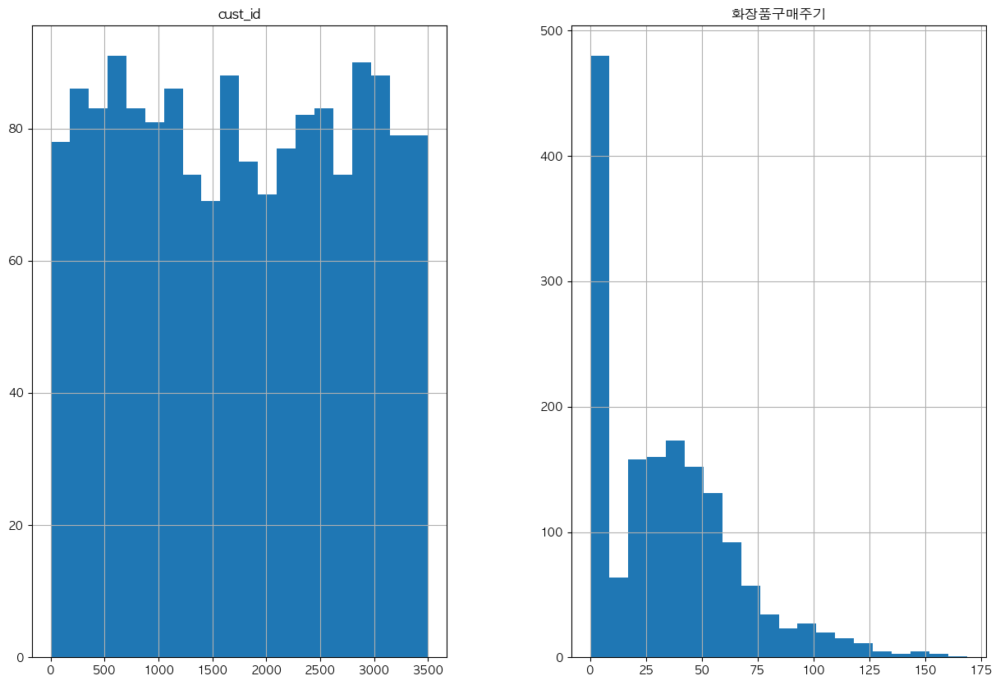

In [29]:
p.hist(bins=20,figsize=(15,10))
plt.show()

### 식료품 구매관련 데이터 확인

In [30]:
#식료품 대분류 확인
#농산물, 가공식품, 축산가공, 수산품, 육류, 차/커피, 젓갈/반찬
tr['gds_grp_mclas_nm'].value_counts()

기타         40753
농산물        33169
가공식품       31015
축산가공       12229
수산품        11680
화장품         9305
디자이너        8583
시티웨어        7317
일용잡화        6670
육류          6239
차/커피        5829
섬유잡화        5549
젓갈/반찬       5400
명품          4778
캐주얼         4504
골프          3975
스포츠         3603
주류          3102
아동          2824
구두          2355
란제리/내의      2167
건강식품        2139
주방용품        2091
남성 캐주얼      1774
모피/피혁       1692
피혁잡화        1561
트래디셔널       1534
셔츠          1472
침구/수예       1343
생활잡화        1121
주방가전        1034
커리어          970
남성정장         962
식기           795
액세서리         764
대형가전         405
가구           323
남성 트랜디       228
소형가전         199
통신/컴퓨터       190
보석           164
기타의류          74
준보석/시계        48
악기            43
교복            18
문구/팬시          9
웨딩             3
전자/전기          1
멀티(아울렛)        1
Name: gds_grp_mclas_nm, dtype: int64

In [33]:
#식료품 소분류 확인
#농산가공, 청과, 야채, 유기농야채, 건과, 산지통합, 곡물, 선식(가루류), 농산단기행사, 특수야채, 식자재
test=tr.loc[(tr.gds_grp_mclas_nm=='농산물')&(tr.gds_grp_nm),] #>> ex)농산물의 하위 분류 모두 추출
test['gds_grp_nm'].value_counts()

농산가공       11467
청과          6785
야채          5725
유기농야채       5432
건과          1604
산지통합         892
곡물           803
선식(가루류)      385
농산단기행사        40
특수야채          35
식자재            1
Name: gds_grp_nm, dtype: int64

### 식료품 구매비율

In [34]:
food=['농산물', '가공식품', '축산가공', '수산품', '육류', '차/커피', '젓갈/반찬'] 

#식료품 구매비율 = 식품구매액/총구매액
p=tr.groupby('cust_id')['amount'].agg([('총구매액',np.sum)]).reset_index()
food_amount=tr.query('gds_grp_mclas_nm==@food').groupby('cust_id')['amount'].agg([
    ('식료품구매액',np.sum)
]).reset_index()
p=pd.merge(p,food_amount,on='cust_id',how='left').fillna(0)

p['식료품구매액비율']=p['식료품구매액']/p['총구매액']
p['식료품구매액비율']=np.round(p['식료품구매액비율'],2)
features=features.merge(p[['cust_id','식료품구매액비율']],how='left')

In [43]:
#총구매액
p=tr.groupby('cust_id')['amount'].agg([
    ('총구매액',np.sum)
]).reset_index()

In [36]:
p

,cust_id,총구매액,식료품구매액,식료품구매액비율
0,0,68282840,1721940.0,0.03
1,1,2136000,0.0,0.00
2,2,3197000,0.0,0.00
3,3,16077620,3815490.0,0.24
4,4,29050000,0.0,0.00
...,...,...,...,...
3495,3495,3175200,0.0,0.00
3496,3496,29628600,0.0,0.00
3497,3497,75000,0.0,0.00
3498,3498,1875000,0.0,0.00


In [37]:
food=['농산물', '가공식품', '축산가공', '수산품', '육류', '차/커피', '젓갈/반찬']
pk=tr.query('gds_grp_mclas_nm==@food').groupby('cust_id')['amount'].agg([
    ('식료품구매액',lambda x:round(np.sum(x)))
]).reset_index()

pk2=tr.query('gds_grp_mclas_nm==@food').groupby('cust_id')['amount'].agg([
    ('식료품구매건수',np.size)
]).reset_index()
p=pd.merge(pk,pk2,on='cust_id',how='left').fillna(0)
p['식료품평균구매액']=p['식료품구매액']/p['식료품구매건수']
p['식료품평균구매액']=np.round(p['식료품평균구매액'],)


p['식료품평균구매액분위']=pd.qcut(p['식료품평균구매액'], q=5, labels=range(1,6)).astype(int)
features = features.merge(p[['cust_id', '식료품평균구매액분위']], how = 'left')

In [38]:
price=tr.groupby('goods_id').mean().reset_index().drop(['cust_id'],axis=1)

price.columns=['goods_id','price']
price_4q=price['price'].quantile([.25,.5,.75])
tr=tr.merge(price,how='left')
p=tr.groupby('cust_id')['price'].agg([
    ('고가상품구매율',lambda x:(x>price_4q.iloc[2]).mean().round(2))
]).reset_index()
features=features.merge(p,how='left')

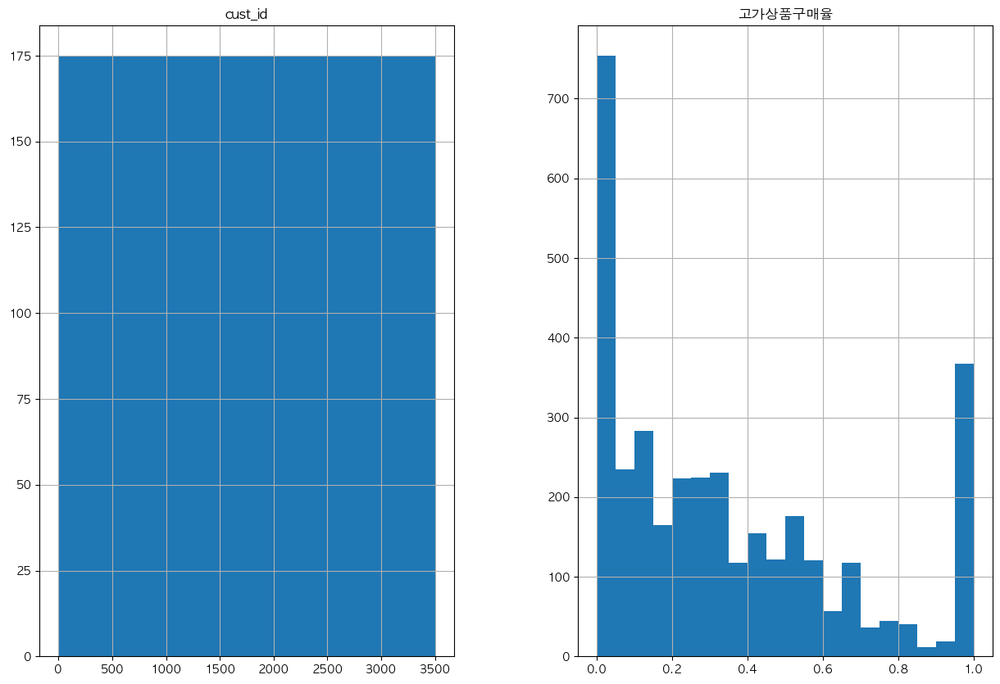

In [39]:
p.hist(bins=20, figsize=(15,10))
plt.show()

In [40]:
#베스트셀러 Top10을 찾기위한 코드
#tr.groupby('gds_grp_mclas_nm')['amount'].size()
#가공식품, 기타, 농산물, 수산품, 축산가공, 화장품, 디자이너, 시티웨어, 일용잡화,차/커피

#### 베스트셀러 top10 카테고리 상품 구매건수

In [41]:
best_sellers=['가공식품', '기타', '농산물', '수산품', '축산가공', '화장품', '디자이너', '시티웨어', '일용잡화','차/커피']
p=tr.groupby('cust_id')['amount'].agg([
    ('구매건수',np.size)
]).reset_index()
top10=tr.query('gds_grp_mclas_nm==@best_sellers').groupby('cust_id')['amount'].agg([
    ('top10구매건수',np.size)
]).reset_index()
p=pd.merge(p,top10,on='cust_id',how='left').fillna(0)
p['top10구매비율']=p['top10구매건수']/p['구매건수']
features=features.merge(p[['cust_id','top10구매비율']],how='left')

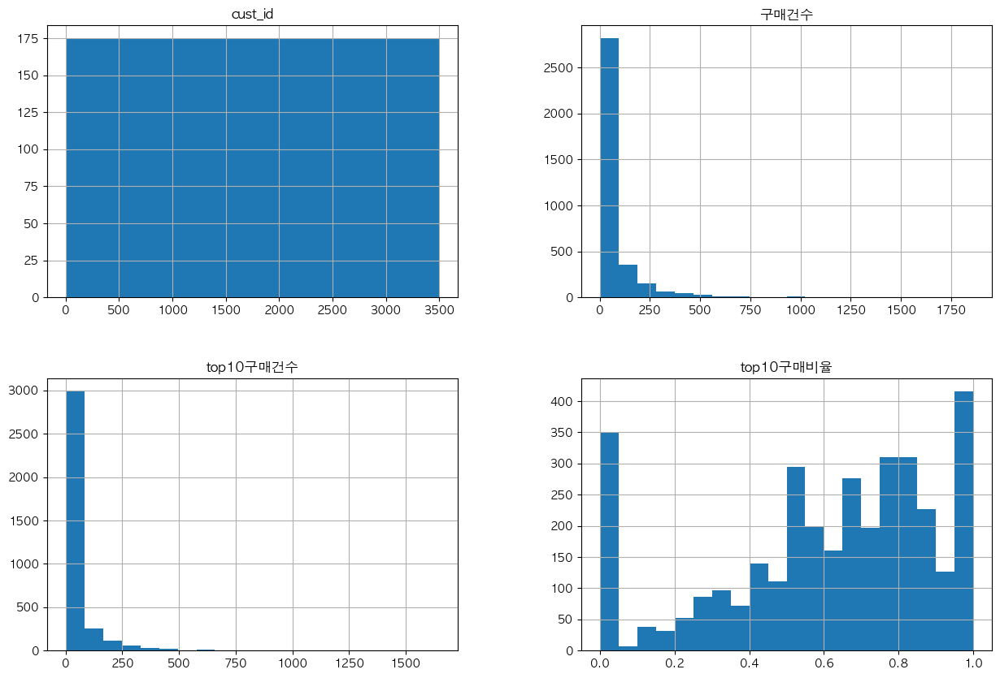

In [42]:
p.hist(bins=20,figsize=(15,10))
plt.show()

### 여성관련 제품 구매건수

In [44]:
#대분류
tr.gds_grp_mclas_nm.unique()
#란제니/내의

array(['화장품', '시티웨어', '기타', '디자이너', '셔츠', '축산가공', '건강식품', '육류', '수산품',
       '젓갈/반찬', '가공식품', '농산물', '란제리/내의', '스포츠', '섬유잡화', '남성정장', '골프',
       '트래디셔널', '남성 캐주얼', '침구/수예', '일용잡화', '캐주얼', '차/커피', '아동', '구두',
       '보석', '주방용품', '액세서리', '명품', '식기', '주류', '주방가전', '생활잡화', '소형가전',
       '커리어', '피혁잡화', '가구', '모피/피혁', '대형가전', '준보석/시계', '교복', '남성 트랜디',
       '기타의류', '악기', '통신/컴퓨터', '전자/전기', '문구/팬시', '웨딩', '멀티(아울렛)'],
      dtype=object)

In [45]:
#소분류
tr.gds_grp_nm.unique()
#란제리행사, 뷰티상품, 캐릭터 여화,스타킹(특정), 색조 화장품, NB 여화, 숙녀단기행사, 숙녀고정행사, 직수입핸드백, 헤어ACC, 란제리(멀티)

array(['기초 화장품', '니  트', '상품군미지정', '디자이너부틱', '비지니스군', '유제품', '건강식품',
       '건강식품(비타민)', '계육', '멸치류', '벌크젓갈', '일반가공식품', '우육', '수입육', '청과',
       '란제리행사', '생선', '시티웨어', '고정행사(스포츠)', '돈육', '단기행사(스포츠)', '굴비류',
       '양말(특정)', 'N.B정장', 'N/B골프의류', '스카프(특정)', '건강식품(홍삼)', '모자(특정)',
       '아웃도아', '트래디셔널Ⅰ', '시티캐주얼', '회', '한실침구', '뷰티상품', '산지통합', '이지캐주얼',
       '수입식품', '야채', '농산가공', 'L/C 아동복', '캐릭터 여화', '위생세제', '스타킹(특정)', '떡',
       '보석', '국산주방', '편집매장', '주방잡화', '수입ACC', '캐릭터 남화', '명품잡화', '어덜트',
       '크리스탈', '주류', '디자이너캐릭터', '기타', '컨템포러리', '전기밥솥', '수      저', '란제리',
       '디자이너', '휴지류', '가공행사', '색조 화장품', '트래디셔널Ⅱ', 'NB 여화', '수영복', '장류',
       '벌크김치', '건과', '직수입 골프의류', '진캐주얼', '김류', '트래디셔널', '패션내의', 'KKD',
       '타월', '욕실용품', '가스기기', '건생선', '즉석구이김류', '포숑', '양념육', '밥류',
       '패밀리레스토랑', '원두커피', '곡물', '유기농야채', '일용잡화', '선식(가루류)', '국산ACC',
       '토탈데코', '커리어', '양과(세트행사)', 'takeout양과', '스포츠화', 'L/C골프의류', '영캐주얼',
       '4대 B/D', '우/양산(특정)', '장갑(특정)', '디저트류', 'N/B 아동복', '초밥', '음료',
       '즉석

In [46]:
female_items=['디자이너부틱','어덜트','란제리행사','뷰티상품','스타킹(특정)','보석',
               '크리스탈','란제리','디자이너','색조 화장품','NB 여화','일반핸드백',
               '직수입핸드백','숙녀단기행사','숙녀고정행사','영플라자(핸드백)','14K',
               '모피','머플러(특정)','명품잡화보석','명품보석','수입잡화보석',
               '주얼리멀티','란제리(멀티)','스카프(특정)']
p=tr.groupby('cust_id')['amount'].agg([
    ('구매건수',np.size)
]).reset_index()
female_items_buy=tr.query('gds_grp_nm==@female_items').groupby('cust_id')['amount'].agg([
    ('여성제품구매',np.size)
]).reset_index()
p=pd.merge(p,female_items_buy,how='left').fillna(0)
p['여성제품구매비율']=p['여성제품구매']/p['구매건수']
features=features.merge(p[['cust_id','여성제품구매비율']],how='left')

In [47]:
male_items=['N.B정장','N/B골프의류','주류','직수입 골프의류','스포츠화',
             'L/C골프의류','L/C정장','단기행사(골프)','스포츠의류','레포츠',
             '안주류','시계','넥타이(특정)','고정행사(골프)','등산화','골프용품',
             '명품남성','셔츠고정행사','셔츠단기행사','명품시계기타',
             '기타(가발,포장,담배,끽연구,사진,수선)','정상스포츠','단기행사(레져)',
             '고정행사(레져)','시티정장바지','넥타이핀','직수입정장','맞춤셔츠',
             '셔츠 직매입(PB)','IT 게임기','명품시계직매입','남성잡화멀티',
             '정장점행사','NB 남화','남성시티 직매입']

p=tr.groupby('cust_id')['amount'].agg([
    ('구매건수',np.size)
]).reset_index()
male_items_buy=tr.query('gds_grp_nm==@male_items').groupby('cust_id')['amount'].agg([
    ('남성제품구매',np.size)
]).reset_index()
p=pd.merge(p,male_items_buy,how='left').fillna(0)
p['남성제품구매비율']=p['남성제품구매']/p['구매건수']
features=features.merge(p[['cust_id','남성제품구매비율']],how='left');features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,주구매상품,주구매지점,기울기,구매 추세 기울기,식료품구매액비율,식료품평균구매액분위,고가상품구매율,top10구매비율,여성제품구매비율,남성제품구매비율
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,기타,강남점,NaN,0.97,0.03,2.0,0.24,0.554054,0.094595,0.027027
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,스포츠,잠실점,NaN,0.07,0.00,NaN,0.33,0.000000,0.000000,0.000000
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,남성 캐주얼,관악점,NaN,-0.15,0.00,NaN,0.00,0.500000,0.000000,0.000000
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,기타,광주점,NaN,-0.38,0.24,4.0,0.07,0.818182,0.068182,0.000000
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,화장품,본 점,NaN,0.05,0.00,NaN,1.00,0.666667,0.333333,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,골프,본 점,NaN,-0.01,0.00,NaN,0.00,0.500000,0.000000,0.500000
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,시티웨어,부산본점,NaN,0.23,0.00,NaN,0.62,0.769231,0.000000,0.153846
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,주방용품,창원점,NaN,-0.04,0.00,NaN,0.00,0.000000,0.000000,0.000000
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,화장품,본 점,NaN,-0.06,0.00,NaN,1.00,1.000000,0.000000,0.000000


### 롯데백화점 MVG조건 (2020기준)
  - 해당하지 않는 고객들은 silver로 설정 -> 10
  - 400만원 이상: Vip -> 20
  - 800만원 이상: Vip+ -> 30
  - 1800~2000만원이상: MVG-Ace  -> 40
  - 4000만원이상: MVG-Crown -> 50
  - 6000만원이상: MVG-Prestige -> 60
  - 1억이상: LENITH -> 70

In [48]:
#롯데백화점 MVG기준으로 분할
def cust_level(x):
    if 4000000<=x<8000000:
        return 200
    elif 8000000<=x<18000000:
        return 300
    elif 18000000<=x<20000000:
        return 400
    elif 40000000<x<60000000:
        return 500
    elif 60000000<=x<100000000:
        return 600
    elif x>=100000000:
        return 700
    else:
        return 100

In [49]:
p=tr.groupby('cust_id')['amount'].sum().reset_index()
p['class']=p['amount'].agg(cust_level)
features=features.merge(p[['cust_id','class']],how='left');features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,주구매지점,기울기,구매 추세 기울기,식료품구매액비율,식료품평균구매액분위,고가상품구매율,top10구매비율,여성제품구매비율,남성제품구매비율,class
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,강남점,NaN,0.97,0.03,2.0,0.24,0.554054,0.094595,0.027027,600
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,잠실점,NaN,0.07,0.00,NaN,0.33,0.000000,0.000000,0.000000,100
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,관악점,NaN,-0.15,0.00,NaN,0.00,0.500000,0.000000,0.000000,100
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,광주점,NaN,-0.38,0.24,4.0,0.07,0.818182,0.068182,0.000000,300
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,본 점,NaN,0.05,0.00,NaN,1.00,0.666667,0.333333,0.000000,100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,본 점,NaN,-0.01,0.00,NaN,0.00,0.500000,0.000000,0.500000,100
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,부산본점,NaN,0.23,0.00,NaN,0.62,0.769231,0.000000,0.153846,100
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,창원점,NaN,-0.04,0.00,NaN,0.00,0.000000,0.000000,0.000000,100
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,본 점,NaN,-0.06,0.00,NaN,1.00,1.000000,0.000000,0.000000,100


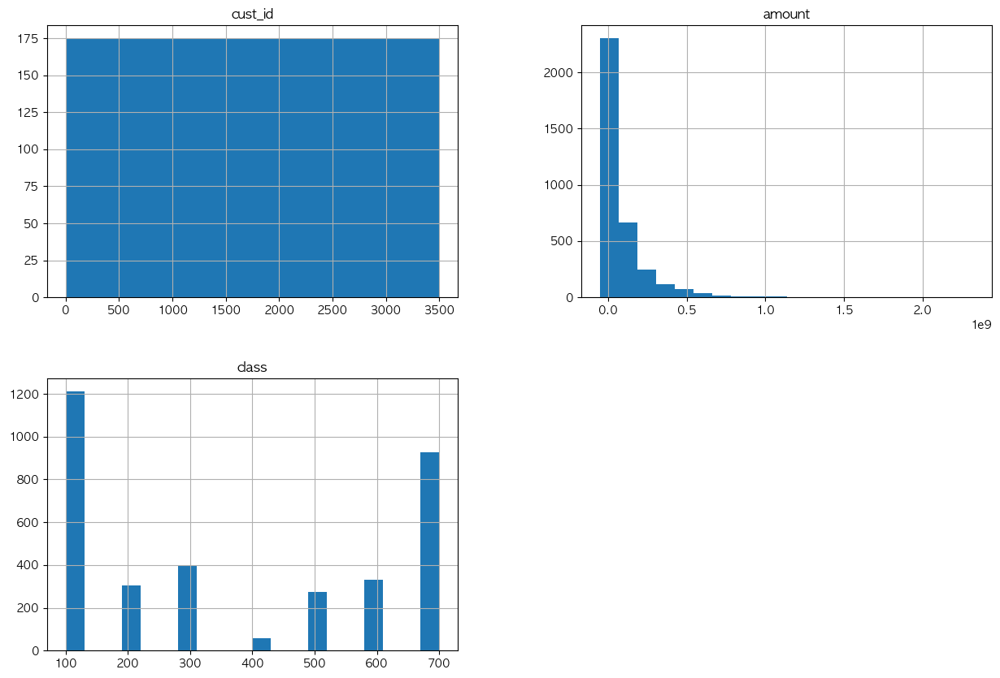

In [50]:
p.hist(bins=20, figsize=(15,10))
plt.show()

## 기타 파생변수
* 유의하지 않은 변수로 판단하여 학습에서 제외된 또는 해석에 어려움이 있어 보류해놓은 변수들

### 고객들의 소비성향을 추출

In [52]:
# p['전체고객 평균 구매액']=0
# p.head()
# p['소비성향']=0
# p.head()
# p['전체고객 평균 구매액']= p['총구매액'].sum()/35000
# p['소비성향'] = p['총구매액']-p['전체고객 평균 구매액']
# p.head()

### 충동소비 경향

In [53]:
# p['충동 소비 성향'] = p['최대구매액'] - p['평균구매액'].round()
# p.head()

### 휴면고객
* n개월 이상 구매가 없는 고객을 휴면고객으로 정의
* 같은 원리로 n개월 이상 구매가 없는 고객을 이탈 고객으로 정의할 수 있을것.

In [54]:
# p = tr.groupby('cust_id')['tran_date'].agg([
#     ('휴면고객 여부', lambda x: np.mean(pd.to_datetime(x).dt.month.isin([9,10,11]))),
#     ]).reset_index()
# display(p)

In [ ]:
#f = A.groupby('cust_id')['tran_date'].agg([
#('휴면고객', lambda x:x=0, range(1))으로 3개월 간 방문기록이 0인 고객을
# 휴면고객으로 정의하려 했습니다.

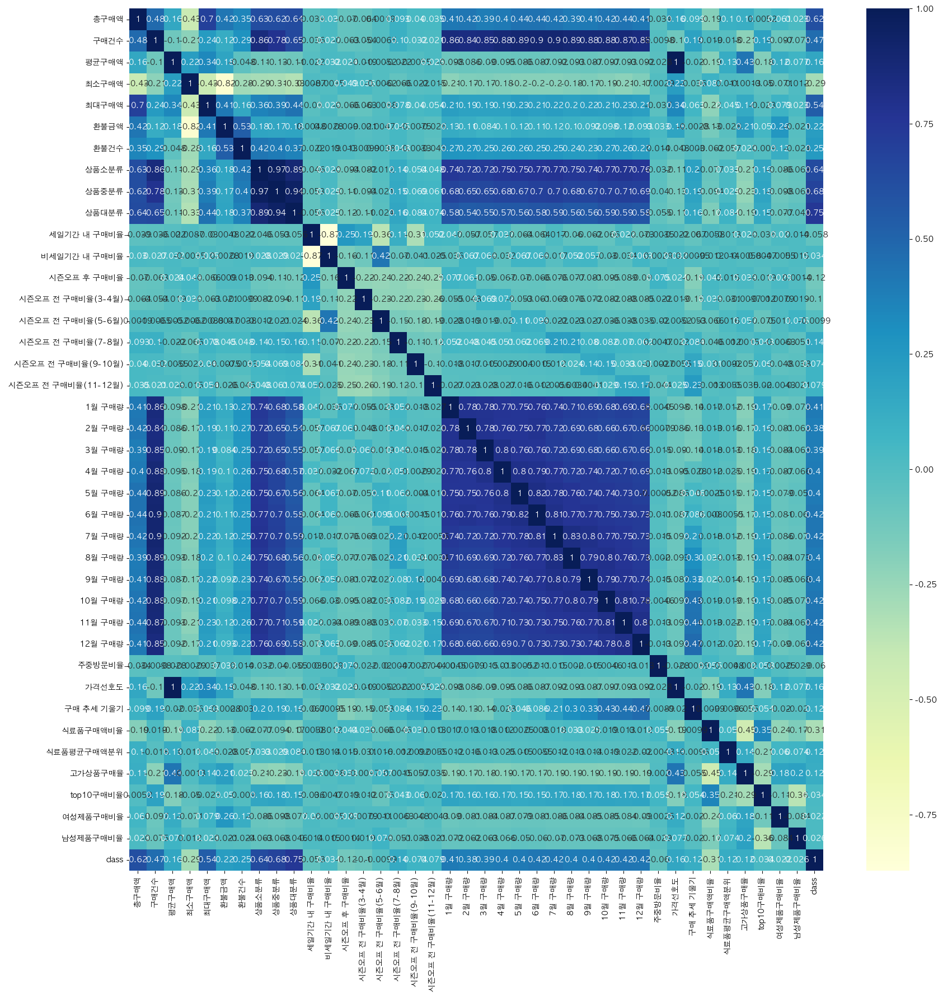

In [58]:
plt.figure(figsize=(20,20))
sns.heatmap(features.iloc[:,1:].corr(), annot=True, cmap="YlGnBu")
plt.show()

In [59]:
display(features)
features.to_csv('features.csv', index=False, encoding='cp949')
features.info()

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,주구매지점,기울기,구매 추세 기울기,식료품구매액비율,식료품평균구매액분위,고가상품구매율,top10구매비율,여성제품구매비율,남성제품구매비율,class
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,강남점,NaN,0.97,0.03,2.0,0.24,0.554054,0.094595,0.027027,600
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,잠실점,NaN,0.07,0.00,NaN,0.33,0.000000,0.000000,0.000000,100
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,관악점,NaN,-0.15,0.00,NaN,0.00,0.500000,0.000000,0.000000,100
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,광주점,NaN,-0.38,0.24,4.0,0.07,0.818182,0.068182,0.000000,300
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,본 점,NaN,0.05,0.00,NaN,1.00,0.666667,0.333333,0.000000,100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,본 점,NaN,-0.01,0.00,NaN,0.00,0.500000,0.000000,0.500000,100
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,부산본점,NaN,0.23,0.00,NaN,0.62,0.769231,0.000000,0.153846,100
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,창원점,NaN,-0.04,0.00,NaN,0.00,0.000000,0.000000,0.000000,100
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,본 점,NaN,-0.06,0.00,NaN,1.00,1.000000,0.000000,0.000000,100


<class 'pandas.core.frame.DataFrame'>
Int64Index: 3500 entries, 0 to 3499
Data columns (total 44 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   cust_id               3500 non-null   object 
 1   총구매액                  3500 non-null   int64  
 2   구매건수                  3500 non-null   int64  
 3   평균구매액                 3500 non-null   float64
 4   최소구매액                 3500 non-null   int64  
 5   최대구매액                 3500 non-null   int64  
 6   환불금액                  1205 non-null   float64
 7   환불건수                  1205 non-null   float64
 8   상품소분류                 3500 non-null   int64  
 9   상품중분류                 3500 non-null   int64  
 10  상품대분류                 3500 non-null   int64  
 11  세일기간 내 구매비율           3500 non-null   float64
 12  비세일기간 내 구매비율          3500 non-null   float64
 13  시즌오프 후 구매비율           3500 non-null   float64
 14   시즌오프 전 구매비율(3-4월)    3500 non-null   float64
 15   시즌오프 전 구매비율(5-6월)   

____

### 1. ML_features1을 이용하여 학습

In [66]:
import klib

In [79]:
# !conda install -c conda-forge klib --yes

In [77]:
features=pd.read_csv('features.csv',encoding='cp949')
target=pd.read_csv('target.csv').gender
features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,주구매지점,기울기,구매 추세 기울기,식료품구매액비율,식료품평균구매액분위,고가상품구매율,top10구매비율,여성제품구매비율,남성제품구매비율,class
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,강남점,NaN,0.97,0.03,2.0,0.24,0.554054,0.094595,0.027027,600
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,잠실점,NaN,0.07,0.00,NaN,0.33,0.000000,0.000000,0.000000,100
2,2,3197000,4,799250.0,64500,1639000,NaN,NaN,1,2,...,관악점,NaN,-0.15,0.00,NaN,0.00,0.500000,0.000000,0.000000,100
3,3,16077620,44,365400.0,1800,4935000,NaN,NaN,24,20,...,광주점,NaN,-0.38,0.24,4.0,0.07,0.818182,0.068182,0.000000,300
4,4,29050000,3,9683333.0,2050000,24000000,NaN,NaN,2,3,...,본 점,NaN,0.05,0.00,NaN,1.00,0.666667,0.333333,0.000000,100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,NaN,NaN,1,2,...,본 점,NaN,-0.01,0.00,NaN,0.00,0.500000,0.000000,0.500000,100
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,부산본점,NaN,0.23,0.00,NaN,0.62,0.769231,0.000000,0.153846,100
3497,3497,75000,1,75000.0,75000,75000,NaN,NaN,1,1,...,창원점,NaN,-0.04,0.00,NaN,0.00,0.000000,0.000000,0.000000,100
3498,3498,1875000,2,937500.0,875000,1000000,NaN,NaN,1,1,...,본 점,NaN,-0.06,0.00,NaN,1.00,1.000000,0.000000,0.000000,100


### 2. EDA

In [78]:
# ...
#matplotlib 한글꺠짐 지원#matplotlib 한글깨짐 지원
import platform

path = "c:/Windows/Fonts/malgun.ttf"
if platform.system() == 'Darwin':
    rc('font', family='AppleGothic')
elif platform.system() == 'Windows':
    font_name = font_manager.FontProperties(fname=path).get_name()
    rc('font', family=font_name)
else:
    print('Unknown system...')
rc('axes', unicode_minus=False)

### Missing value plot
* 환불금액 / 환불건수 / 기울기 / 식료품평균구매액분위 /월별 구매액

GridSpec(6, 6)

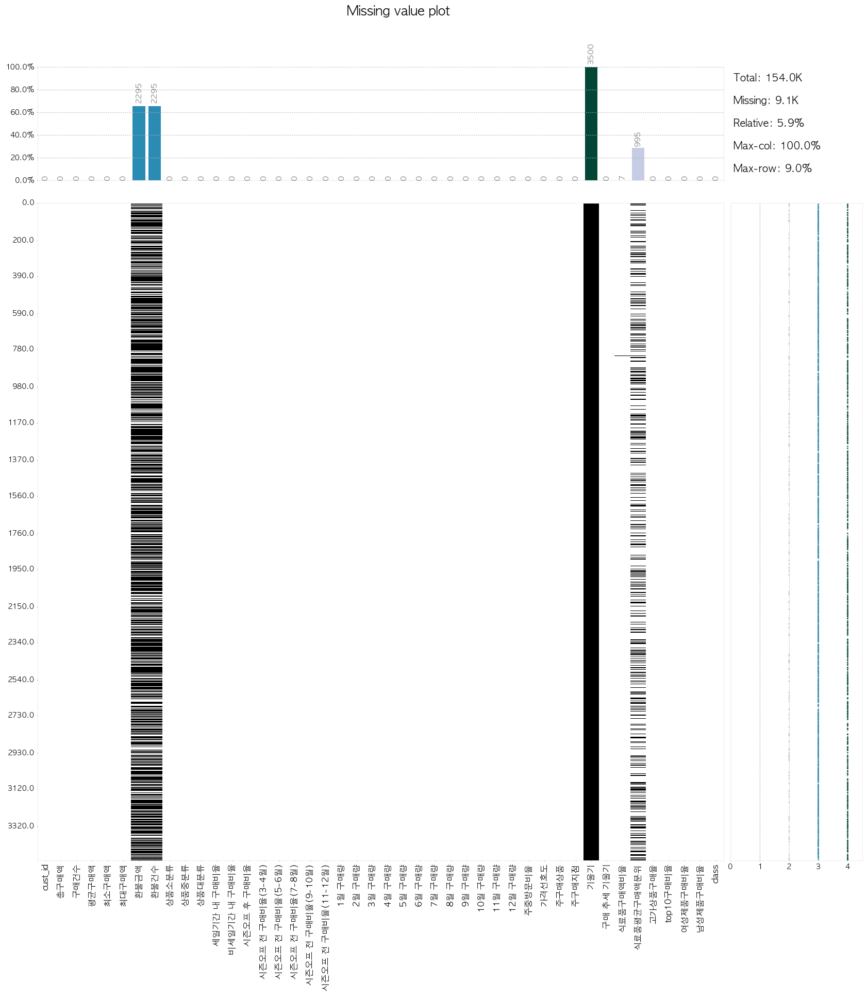

In [80]:
klib.missingval_plot(features)

In [101]:
#pandas version check >> 1.5.0 version부터 가능
klib.corr_plot(features,annot=False,figsize=(15,12))
klib.corr_polt(features,split='high',annot=False,figsize=(15,12))

TypeError: corr() got an unexpected keyword argument 'numeric_only'

GridSpec(6, 2)

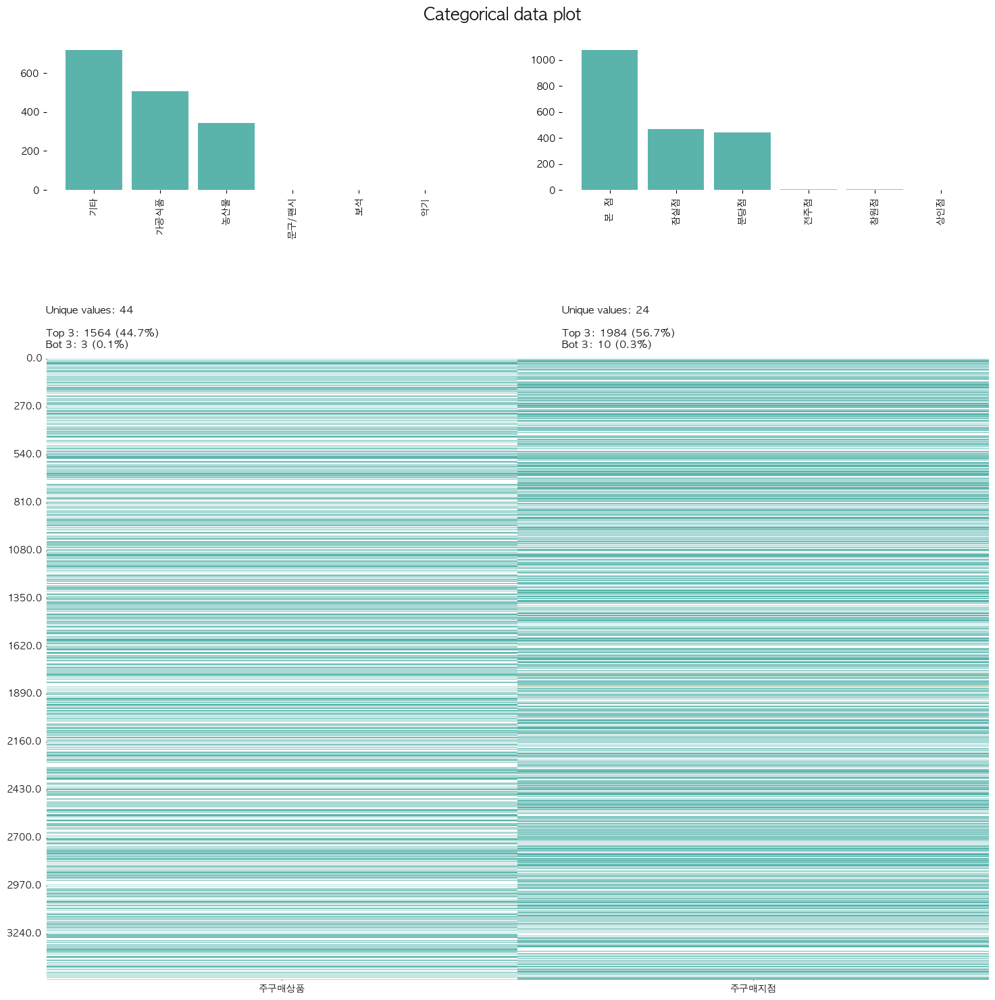

In [81]:
klib.cat_plot(features)

Note: The number of non binary numerical features is very large (41), please consider splitting the data. Showing plots for the first 20 numerical features. Override this by setting showall=True.


<AxesSubplot:xlabel='1월 구매량', ylabel='Density'>

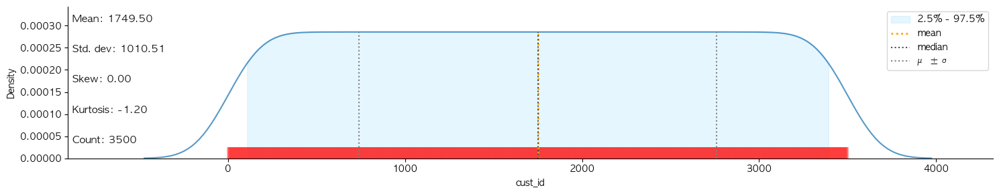

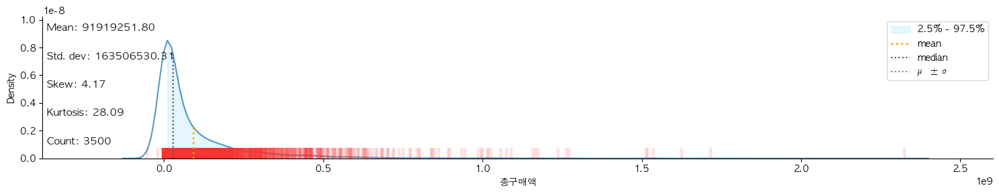

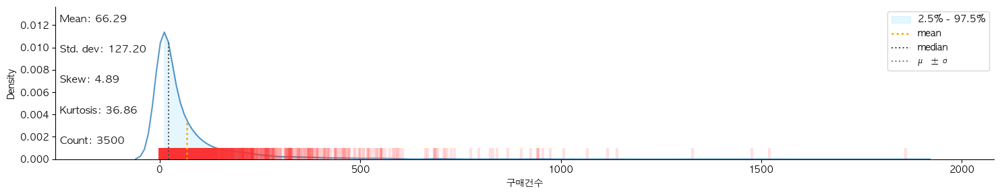

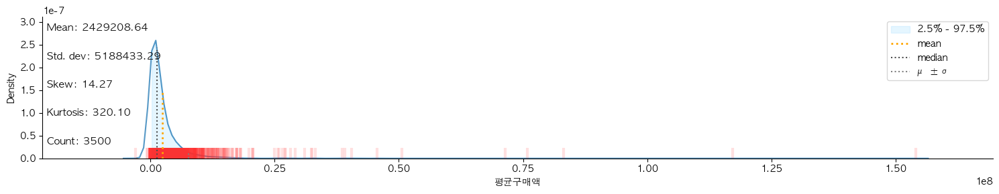

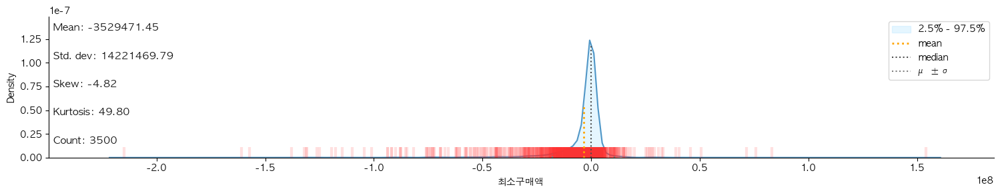

...

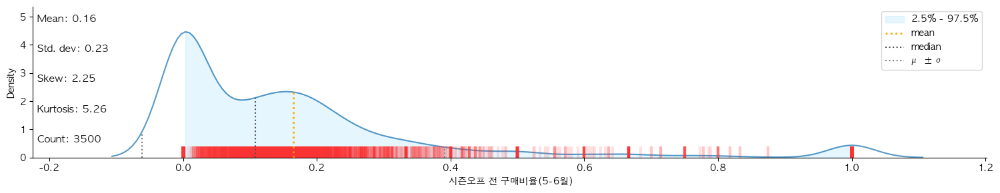

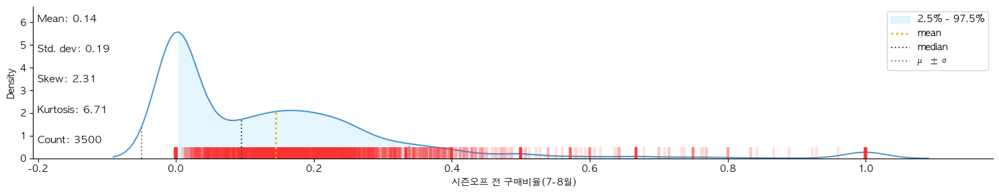

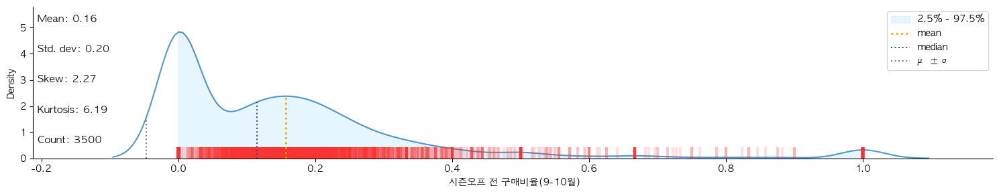

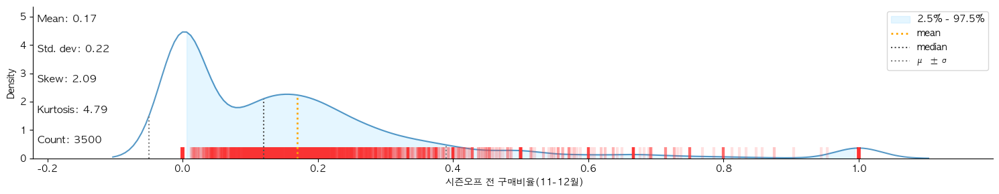

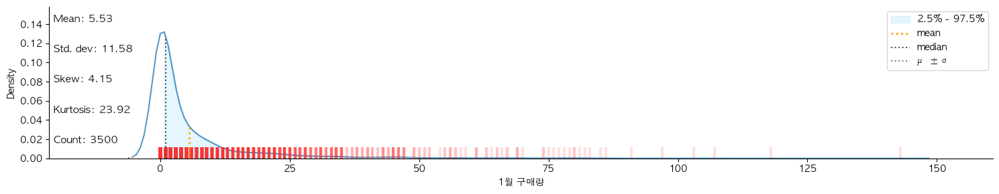

In [70]:
klib.dist_plot(features)

In [82]:
klib.corr_plot(pd.merge(features.pd.read_csv('target.csv'),)), target='gender'

SyntaxError: cannot assign to function call (3766058551.py, line 1)

In [74]:
# 범주형 변수와 수치형 변수를 분리
cat_features = list(features.select_dtypes(include=['object']).columns)
num_features = [c for c in features.columns.tolist() if c not in cat_features]

# 결측값 처리
features[cat_features] = features[cat_features].fillna('None')
features[num_features] = features[num_features].fillna(0)

# 범주형 변수에 One-Hot-Encoding 후 수치형 변수와 병합
if len(cat_features) > 0:
    features = pd.concat([features[num_features], pd.get_dummies(features[cat_features])], axis=1)

features

,cust_id,총구매액,구매건수,평균구매액,최소구매액,최대구매액,환불금액,환불건수,상품소분류,상품중분류,...,주구매지점_안양점,주구매지점_영등포점,주구매지점_울산점,주구매지점_인천점,주구매지점_일산점,주구매지점_잠실점,주구매지점_전주점,주구매지점_창원점,주구매지점_청량리점,주구매지점_포항점
0,0,68282840,74,922741.0,-5368000,11264000,6860000.0,3.0,35,28,...,0,0,0,0,0,0,0,0,0,0
1,1,2136000,3,712000.0,-300000,2136000,300000.0,1.0,2,2,...,0,0,0,0,0,1,0,0,0,0
2,2,3197000,4,799250.0,64500,1639000,0.0,0.0,1,2,...,0,0,0,0,0,0,0,0,0,0
3,3,16077620,44,365400.0,1800,4935000,0.0,0.0,24,20,...,0,0,0,0,0,0,0,0,0,0
4,4,29050000,3,9683333.0,2050000,24000000,0.0,0.0,2,3,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,3495,3175200,2,1587600.0,132300,3042900,0.0,0.0,1,2,...,0,0,0,0,0,0,0,0,0,0
3496,3496,29628600,13,2279123.0,-6049600,7200000,6049600.0,1.0,9,7,...,0,0,0,0,0,0,0,0,0,0
3497,3497,75000,1,75000.0,75000,75000,0.0,0.0,1,1,...,0,0,0,0,0,0,0,1,0,0
3498,3498,1875000,2,937500.0,875000,1000000,0.0,0.0,1,1,...,0,0,0,0,0,0,0,0,0,0
